In [1]:
import math
import numpy as np              # please next time include the relevant
import matplotlib.pyplot as plt # `import` statements and variable
import matplotlib.animation as animation
%matplotlib inline
from scipy.interpolate import interp1d
pi = np.pi                      # definitions

In [2]:
def orbitsys(u):
    r, pr, phi = u
    dpr = lz**2/(m*r**3)-k/r**2
    dr = pr/m
    dphi = lz/(m*r**2)
    return np.array([dr, dpr, dphi]);

In [3]:
def Eulerstep(f,u,dt): return u+dt*f(u)

def Eulerintegrate(f, y0, tspan):
    y = np.zeros([len(tspan),len(y0)])
    y[0,:]=y0
    for k in range(1, len(tspan)):
        result = Eulerstep(f, y[k-1], tspan[k]-tspan[k-1])
        y[k,:] = result
    return y

In [4]:
def RK4step(f,u,dt):
    k1 = dt*f(u)
    k2 = dt*f(u+0.5*k1)
    k3 = dt*f(u+0.5*k2)
    k4 = dt*f(u+k3)
    return u + (k1+2*k2+2*k3+k4)/6

def RK4integrate(f, y0, tspan):
    y = np.zeros([len(tspan),len(y0)])
    y[0,:]=y0
    for k in range(1, len(tspan)):
        result = RK4step(f, y[k-1], tspan[k]-tspan[k-1])
        y[k,:] = result
    return y

rmin for H = Hmin (circular orbit) = lz^2/(km):  0.32320000000000004
rmin for H = 0 (open orbit) = lz^2/(2km):  0.16160000000000002


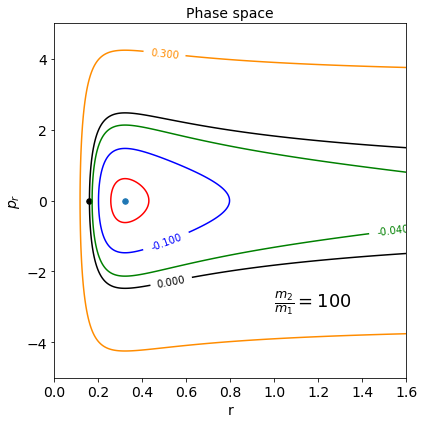

In [5]:
from matplotlib import cm
%matplotlib inline
m1 = 2000
m2 = 20
#print('reduced mass = ', m1*m2/(m1+m2))
m = m1*m2/(m1+m2)
#m = 20
#This is just so the planet moves 'forward' in the configuration space
lz = -0.8
k = 0.1
print('rmin for H = Hmin (circular orbit) = lz^2/(km): ', lz**2/(k*m))
print('rmin for H = 0 (open orbit) = lz^2/(2km): ', lz**2/(2*k*m))
pi = np.pi                      # definitions

contourcolors = ['red','blue','green', 'black', 'darkorange']

# create a figure and axes

fig, ax1 = plt.subplots(nrows=1, ncols=1,figsize=(6,6))
ax1.set_xlabel('r', fontsize = 14)
ax1.set_ylabel(r'$p_r$', fontsize = 14)
ax1.set_title('Phase space', fontsize = 14)
ax1.set_xlim([0,1.6])
plt.yticks(fontsize = 14)
plt.xticks(fontsize = 14)
rcont = np.linspace(0.1,1.6,400)
pcont = np.linspace(-5,5,400)
rcont, pcont = np.meshgrid(rcont, pcont)
ham = (pcont**2/(2*m) + lz**2/(2*m*rcont**2) - k/rcont)

#im = ax1.imshow(ham, interpolation='nearest', aspect='auto', extent=(0, 1.6, -5, 5), cmap = cm.twilight)
ax1.scatter(lz**2/(k*m), 0, s = 30)
ax1.scatter(lz**2/(2*k*m), 0, s = 30, color ='black')
#ax1.text(1.2, -3, r'$\frac{m_2}{m_1} = 100$')

cs = ax1.contour(rcont, pcont, ham, levels = [-0.145,-0.1,-0.04,0,0.3], colors = contourcolors)
ax1.clabel(cs, cs.levels, inline=True, fontsize=10)
ax1.text(1,-3, r'$\frac{m_2}{m_1} = 100$', fontsize=18)

plt.tight_layout()

In [6]:
fig.savefig('Hamiltonian_contours.pdf')

In [7]:
# see https://medium.com/@sssspppp/animated-graphs-in-python-b474dc144e0b for example code
import math
import matplotlib.animation as animation

%matplotlib inline
from scipy.interpolate import interp1d
pi = np.pi                      # definitions
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()

# create a figure and axes
fig = plt.figure(figsize=(6,3))
fig.suptitle(r'H = H$_{min}$ (circular orbits)')
ax1 = plt.subplot(1,2,1)   
ax2 = plt.subplot(1,2,2)
# set up the subplots as needed

ax1.set_xlabel('r')
ax1.set_ylabel('pr')
ax2.set_xlabel('x')
ax2.set_ylabel('y')


dt = 0.1
t = np.arange(0,75,dt)

# r, pr, phi

rinit = lz**2/(k*m)
prinit = 0
phiinit = 0
y0 = np.array([rinit, prinit, phiinit ])

sol_RK4 = RK4integrate(orbitsys, y0, t)
r, pr, phi = sol_RK4.T
#phi = -phi
H = (pr**2/(2*m) + lz**2/(2*m*r**2) - k/r)
L = m*r[1:]**2*[(phi[i+1]-phi[i])/(t[i+1]-t[i]) for i in range(len(t)-1)]

# make contour plot of the Hamiltonian
txt_title = ax1.set_title('')
rcont = np.linspace(0.1,1.6,400)
pcont = np.linspace(-5,5,400)
rcont, pcont = np.meshgrid(rcont, pcont)
ham = (pcont**2/(2*m) + lz**2/(2*m*rcont**2) - k/rcont)


cs = ax1.contour(rcont,pcont,ham, levels = [-0.145,-0.1,-0.04,0,0.3], colors = contourcolors)
ax1.clabel(cs, cs.levels, inline=True, fontsize=10)

# Create objects that will change in the animation. 
# Initially empty, have new values in the animation.

# plot the line
ax1.plot(r,pr) 
# create a point
pt2, = ax1.plot([], [], 'b.', ms=10)  

ax1.set_title('Phase space')
ax2.set_title('Configuration space')

# plot the line
ax2.plot(r*np.cos(phi),r*np.sin(phi))  
ax2.text(-0.3,-0.3, r'$\frac{m_2}{m_1} = 100$', color='black', fontsize=10)
ax2.plot([0], [0], 'm.', ms=10)

# create the point
pt1, = ax2.plot([], [], 'b.', ms=10) 
ax2.set_xlim([-0.35,0.35])
ax2.set_ylim([-0.35,0.35])

def drawframe(n):
    x = r
    y1 = pr
    y2 = phi
    t = np.arange(0,75,dt)
    funcr = interp1d(t,r)
    funcpr = interp1d(t,pr)
    funcphi = interp1d(t,phi)
    t = np.linspace(0,75)
    pt2.set_data(funcr(t[n]), funcpr(t[n]))
    pt1.set_data(funcr(t[n])*np.cos(funcphi(t[n])),funcr(t[n])*np.sin(funcphi(t[n])))
    return pt2, pt1,

from matplotlib import animation
# blit=True updates only the changed parts
ani = animation.FuncAnimation(fig, drawframe, frames=45, interval=50, blit=True )
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.close()
ani

In [8]:
ani.save('phase_space_mostly_circular.mp4')

In [9]:
# create a figure and axes
fig = plt.figure(figsize=(6,3))
fig.suptitle('H < 0 (elliptical orbits)')
ax1 = plt.subplot(1,2,1)   
ax2 = plt.subplot(1,2,2)
# set up the subplots as needed

ax1.set_xlabel('r')
ax1.set_ylabel('pr')
ax2.set_xlabel('x')
ax2.set_ylabel('y')


tmax = 100
dt = 0.1
t = np.arange(0,tmax,dt)

# r, pr, phi
rinit = 0.202
prinit = 0
phiinit = 0
y0 = np.array([rinit, prinit, phiinit ])

sol_RK4 = RK4integrate(orbitsys, y0, t)
r, pr, phi = sol_RK4.T
#phi = -phi
H = (pr**2/(2*m) + lz**2/(2*m*r**2) - k/r)
L = m*r[1:]**2*[(phi[i+1]-phi[i])/(t[i+1]-t[i]) for i in range(len(t)-1)]

# make contour plot of the Hamiltonian
txt_title = ax1.set_title('')
rcont = np.linspace(0.1,2,400)
pcont = np.linspace(-5,5,400)
rcont, pcont = np.meshgrid(rcont, pcont)
ham = (pcont**2/(2*m) + lz**2/(2*m*rcont**2) - k/rcont)


cs = ax1.contour(rcont,pcont,ham, levels = [-0.145,-0.1,-0.04,0,0.3],colors = contourcolors)
ax1.clabel(cs, cs.levels, inline=True, fontsize=10)


# Create objects that will change in the animation. 
# Initially empty, have new values in the animation.

# plot the line
ax1.plot(r,pr) 
# create a point
pt2, = ax1.plot([], [], 'b.', ms=10)  

ax1.set_title('Phase space')
ax2.set_title('Configuration space')

ax1.set_xlim([0,2])
ax1.set_ylim([-4,4])

# plot the line
ax2.plot(r*np.cos(phi),r*np.sin(phi))  
ax2.text(-0.75,-0.5, r'$\frac{m_2}{m_1} = 100$', color='black', fontsize=10)
ax2.plot([0], [0], 'm.', ms=10)

# create the point
pt1, = ax2.plot([], [], 'b.', ms=10) 
ax2.set_xlim([-0.85,0.25])
ax2.set_ylim([-0.7,0.5])

def drawframe(n):
    x = r
    y1 = pr
    y2 = phi
    t = np.arange(0,tmax,dt)
    funcr = interp1d(t,r)
    funcpr = interp1d(t,pr)
    funcphi = interp1d(t,phi)
    t = np.linspace(0,tmax)
    pt2.set_data(funcr(t[n]), funcpr(t[n]))
    pt1.set_data(funcr(t[n])*np.cos(funcphi(t[n])),funcr(t[n])*np.sin(funcphi(t[n])))
    return pt2, pt1,

from matplotlib import animation
# blit=True updates only the changed parts
ani = animation.FuncAnimation(fig, drawframe, frames=45, interval=50, blit=True )
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.close()
ani

In [10]:
ani.save('phase_space_elliptic.mp4')

In [11]:
# see https://medium.com/@sssspppp/animated-graphs-in-python-b474dc144e0b for example code
import math
import numpy as np              # please next time include the relevant
import matplotlib.pyplot as plt # `import` statements and variable
import matplotlib.animation as animation

%matplotlib inline
from scipy.interpolate import interp1d

        
pi = np.pi                      # definitions
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()

# create a figure and axes
fig = plt.figure(figsize=(6,2.5))
fig.suptitle('H = 0 (Hyperbolic orbits)')
ax1 = plt.subplot(1,2,1)   
ax2 = plt.subplot(1,2,2)
# set up the subplots as needed

ax1.set_xlabel('r')
ax1.set_ylabel('pr')
ax2.set_xlabel('x')
ax2.set_ylabel('y')

dt = 0.01
tmax = 75
t = np.arange(0,tmax,dt)

rinit = 0.161
prinit = 0
phiinit = 0
# r, pr, phi
y0 = np.array([rinit, prinit, phiinit ])
sol_RK4 = RK4integrate(orbitsys, y0, t)
    
r, pr, phi = sol_RK4.T
funcphi = interp1d(r, phi)
funcpr = interp1d(r, pr)

# We set initial r = 3, thus we need corresponding initial angle and momentum
rinit = 3 
prinit = funcpr(rinit)
phiinit = funcphi(rinit)
# set initial conditions to be -prinit, -phiinit just to get nicer looking motion
y0 = np.array([rinit, -prinit, -phiinit ])
sol_RK4 = RK4integrate(orbitsys, y0, t)
    
r, pr, phi = sol_RK4.T
# I make phi = -phi just to show the motion in a more familiar format
#phi = -phi


H = (pr**2/(2*m) + lz**2/(2*m*r**2) - k/r)
L = m*r[1:]**2*[(phi[i+1]-phi[i])/(t[i+1]-t[i]) for i in range(len(t)-1)]

# make contour plot of the Hamiltonian
txt_title = ax1.set_title('')
rcont = np.linspace(0.1,3,400)
pcont = np.linspace(-5,5,400)
rcont, pcont = np.meshgrid(rcont, pcont)
ham = (pcont**2/(2*m) + lz**2/(2*m*rcont**2) - k/rcont)

cs = ax1.contour(rcont,pcont,ham, levels = [-0.145,-0.1,-0.04,0,0.3],colors = contourcolors)
ax1.clabel(cs, cs.levels, inline=True, fontsize=10)

# Create objects that will change in the animation. 
# Initially empty, have new values in the animation.

# plot the line
ax1.plot(r,pr) 
# create a point
pt2, = ax1.plot([], [], 'b.', ms=10)     
ax2.text(0,-1.5, r'$\frac{m_2}{m_1} = 100$', color='black', fontsize=12)

# plot the line
ax2.plot(-r*np.cos(phi),r*np.sin(phi))  

ax2.plot([0], [0], 'm.', ms=10)
# create the point
pt1, = ax2.plot([], [], 'b.', ms=10)
ax1.set_title('Phase space')
ax2.set_title('Configuration space')
ax2.set_xlim([-0.5,3])
ax2.set_ylim([-2, 2])

def drawframe(n):
    x = r
    y1 = pr
    y2 = phi
    t = np.arange(0,tmax,dt)
    funcr = interp1d(t,r)
    funcpr = interp1d(t,pr)
    funcphi = interp1d(t,phi)
    t = np.linspace(0,75)
    pt2.set_data(funcr(t[n]), funcpr(t[n]))
    pt1.set_data(-funcr(t[n])*np.cos(funcphi(t[n])),funcr(t[n])*np.sin(funcphi(t[n])))
    return pt2, pt1,

from matplotlib import animation
# blit=True updates only the changed parts
ani = animation.FuncAnimation(fig, drawframe, frames=45, interval=50, blit=True )
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.close()
ani

In [12]:
ani.save('phase_space_hyperbolic.mp4')

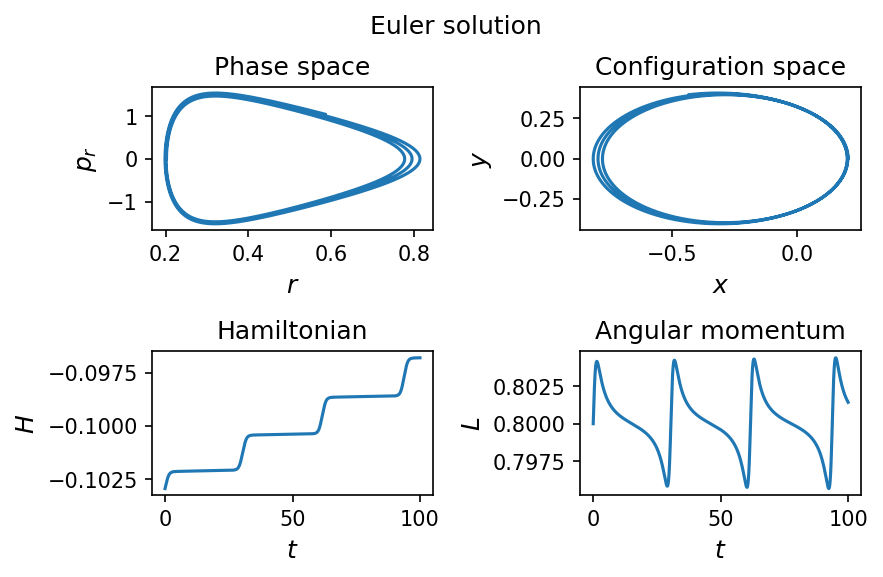

In [13]:
m = 20
lz = 0.8
k = 0.1
plt.ion()

#unstable orbits over a long time 
dt = .01
t = np.arange(0,100,dt)

rinit = 0.202
prinit = 0
phiinit = 0

y0 = np.array([rinit, prinit, phiinit ])
sol_Euler = Eulerintegrate(orbitsys, y0, t)

r,pr,phi = sol_Euler.T
H = 1/2*(pr**2/m + lz**2/(m*r**2)) - k/r
L = m*r[1:]**2*[(phi[i+1]-phi[i])/(t[i+1]-t[i]) for i in range(len(t)-1)]

fig, ax = plt.subplots(2,2,figsize=(6, 4))
fig.suptitle('Euler solution')
ax[0,0].plot(r,pr)
ax[0,0].set_xlabel(r'$r$', fontsize = 12)
ax[0,0].set_ylabel(r'$p_r$', fontsize = 12)
ax[0,0].set_title('Phase space')

ax[0,1].plot(r*np.cos(phi),r*np.sin(phi))
ax[0,1].set_xlabel(r'$x$', fontsize = 12)
ax[0,1].set_ylabel(r'$y$', fontsize = 12)
ax[0,1].set_title('Configuration space')

ax[1,0].plot(t,H)
ax[1,0].set_xlabel(r'$t$', fontsize = 12)
ax[1,0].set_ylabel(r'$H$', fontsize = 12)
ax[1,0].set_title('Hamiltonian')

ax[1,1].plot(t[1:],L)
ax[1,1].set_xlabel(r'$t$', fontsize = 12)
ax[1,1].set_ylabel(r'$L$', fontsize = 12)
ax[1,1].set_title('Angular momentum')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])


In [14]:
fig.savefig('Euler_solution.pdf')

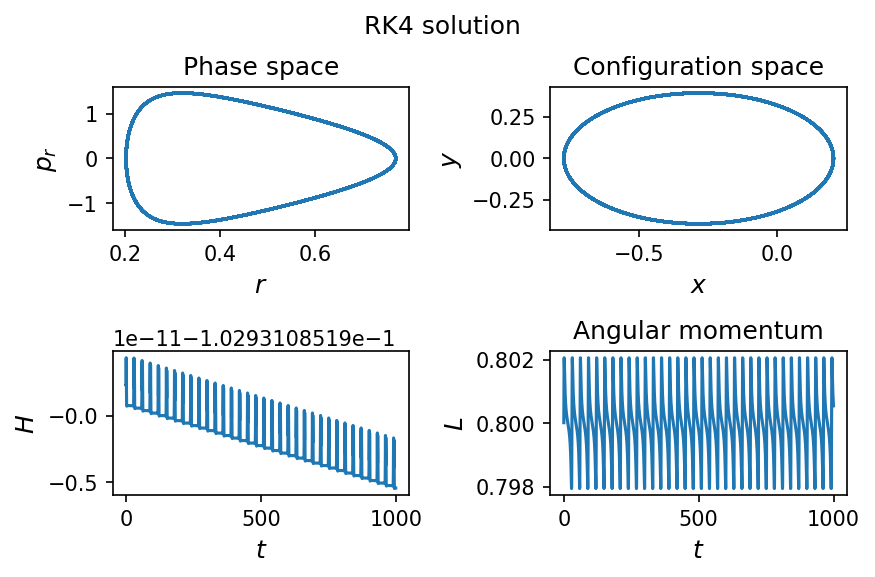

In [15]:
#stable orbits over a long time 
dt = .01

#unstable orbits over a long time 
#dt = 0.2

t = np.arange(0,1000,dt)
y0 = np.array([1, 1.0, 0 ])
y0 = np.array([0.202, 0, 0 ])
sol_RK4 = RK4integrate(orbitsys, y0, t)
r,pr,phi = sol_RK4.T
H = 1/2*(pr**2/m + lz**2/(m*r**2)) - k/r
L = m*r[1:]**2*[(phi[i+1]-phi[i])/(t[i+1]-t[i]) for i in range(len(t)-1)]

fig, ax = plt.subplots(2,2,figsize=(6, 4))
fig.suptitle('RK4 solution')
ax[0,0].plot(r,pr)
ax[0,0].set_xlabel(r'$r$', fontsize = 12)
ax[0,0].set_ylabel(r'$p_r$', fontsize = 12)
ax[0,0].set_title('Phase space')

ax[0,1].plot(r*np.cos(phi),r*np.sin(phi))
ax[0,1].set_xlabel(r'$x$', fontsize = 12)
ax[0,1].set_ylabel(r'$y$', fontsize = 12)
ax[0,1].set_title('Configuration space')

ax[1,0].plot(t,H)
ax[1,0].set_xlabel(r'$t$', fontsize = 12)
ax[1,0].set_ylabel(r'$H$', fontsize = 12)
#ax[1,0].set_title('Hamiltonian')

ax[1,1].plot(t[1:],L)
ax[1,1].set_xlabel(r'$t$', fontsize = 12)
ax[1,1].set_ylabel(r'$L$', fontsize = 12)
ax[1,1].set_title('Angular momentum')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])


In [16]:
fig.savefig('RK4_solution.pdf')

In [17]:
m1 = 40
m2 = 40
m = m1*m2/(m1+m2)
lz = 1.5
k = 0.1
x1 = 4
x2 = 1
pr1init = 1
pr2init = -1

rinit = abs(x1-x2)
prinit = pr1init+pr2init
phiinit = 0

#stable orbits over a long time 
dt = 0.1

#unstable orbits over a long time 
#dt = 0.2
tmax = 1000
t = np.arange(0,tmax,dt)
# y0 is a vector of initial conditions for r, pr and phi 

y0 = np.array([rinit, prinit, phiinit ])

sol_RK4 = RK4integrate(orbitsys, y0, t)
r,pr,phi = sol_RK4.T
phi = -phi

x = r*np.cos(phi)
y = r*np.sin(phi)

x1 = m1/(m1+m2)*x
y1 = m1/(m1+m2)*y

x2 = -m2/(m1+m2)*x
y2 = -m2/(m1+m2)*y

r1 = np.sqrt(x1**2 + y1**2)
r2 = np.sqrt(x2**2 + y2**2)

pr1 = m1/(m1+m2)*pr
pr2 = -m2/(m1+m2)*pr

fig, ax = plt.subplots(1,2,figsize=(10, 5))
fig.suptitle('Motion of two bodies around center of mass')
#fig.suptitle('RK4 solution')

ax[0].plot(r,pr, color = 'black', linestyle = ':')

ax[0].set_xlabel(r'$r$', fontsize = 12)
ax[0].set_ylabel(r'$p_r$', fontsize = 12)
ax[0].set_title('Phase space')

ax[1].plot(x1,y1)
ax[1].plot(x2,y2)

ax[1].set_xlabel(r'$x$', fontsize = 12)
ax[1].set_ylabel(r'$y$', fontsize = 12)
ax[1].text(1,-1.5, r'$\frac{m_2}{m_1} = 1$', color='black', fontsize=10)
ax[1].set_title('Configuration space')

# create the point
pt1, = ax[0].plot([], [], 'k.', ms=10)

# create the point
pt3, = ax[1].plot([], [], 'b.', ms=10)
pt4, = ax[1].plot([], [], 'm.', ms=10)  
ax[1].plot([0], [0], 'r.', ms=10) 
ax[1].set_xlim([-2,2])
ax[1].set_ylim([-2,2])


def drawframe(n):
    x = r
    y1 = pr
    y2 = phi
    t = np.arange(0,tmax,dt)
    
    x = r*np.cos(phi)
    y = r*np.sin(phi)

    x1 = m1/(m1+m2)*x
    y1 = m1/(m1+m2)*y

    x2 = -m2/(m1+m2)*x
    y2 = -m2/(m1+m2)*y

    funcr = interp1d(t,r)
    funcpr = interp1d(t,pr)
    
    funcx1 = interp1d(t,x1)
    funcy1 = interp1d(t,y1)
    
    funcx2 = interp1d(t,x2)
    funcy2 = interp1d(t,y2)
    
    t = np.linspace(0,tmax,100)
    
    pt1.set_data(funcr(t[n]), funcpr(t[n]))

    pt3.set_data(funcx1(t[n]), funcy1(t[n]))
    pt4.set_data(funcx2(t[n]), funcy2(t[n]))
    
    return pt1, pt3, pt4,

from matplotlib import animation
# blit=True updates only the changed parts
ani = animation.FuncAnimation(fig, drawframe, frames=45, interval=1000,  blit=True )

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.close()
ani

In [18]:
ani.save('phase_space_two_bodies_mratio_1.mp4')

In [19]:
m1 = 100
m2 = 66.9
m = m1*m2/(m1+m2)
print('reduced mass = ', m)

lz = 1.5
k = 0.1
x1 = 4
x2 = 1
pr1init = 1
pr2init = -1

rinit = abs(x1-x2)
phiinit = 0

prinit = pr1init+pr2init
#stable orbits over a long time 
dt = 0.1
#unstable orbits over a long time 
#dt = 0.2

tmax = 1000
t = np.arange(0,tmax,dt)
# y0 is a vector of initial conditions for r, pr and phi 

y0 = np.array([rinit, prinit, phiinit ])

sol_RK4 = RK4integrate(orbitsys, y0, t)
r,pr,phi = sol_RK4.T
phi = -phi

x = r*np.cos(phi)
y = r*np.sin(phi)

x1 = m1/(m1+m2)*x
y1 = m1/(m1+m2)*y

x2 = -m2/(m1+m2)*x
y2 = -m2/(m1+m2)*y

r1 = np.sqrt(x1**2 + y1**2)
r2 = np.sqrt(x2**2 + y2**2)

pr1 = m1/(m1+m2)*pr
pr2 = -m2/(m1+m2)*pr

H = (pr**2/m + lz**2/(m*r**2)) - k/r
L = m*r[1:]**2*[(phi[i+1]-phi[i])/(t[i+1]-t[i]) for i in range(len(t)-1)]

fig, ax = plt.subplots(1,2,figsize=(10, 5))
fig.suptitle('Motion of two bodies around center of mass')
#fig.suptitle('RK4 solution')

ax[0].plot(r,pr, color = 'black')

ax[0].set_xlabel(r'$r$', fontsize = 12)
ax[0].set_ylabel(r'$p_r$', fontsize = 12)
ax[0].set_title('Phase space')
ax[0].set_xlim([0,3.5])
ax[0].set_ylim([-3,3])

ax[1].plot(x1,y1)
ax[1].plot(x2,y2)


ax[1].set_xlabel(r'$x$', fontsize = 12)
ax[1].set_ylabel(r'$y$', fontsize = 12)
ax[1].text(1,-1.5, r'$\frac{m_2}{m_1} = 1.5$', color='black', fontsize=10)
ax[1].set_title('Configuration space')
ax[1].set_xlim([-2,2])
ax[1].set_ylim([-2,2])

# create the point
pt1, = ax[0].plot([], [], 'k.', ms=10)

# create the point
pt3, = ax[1].plot([], [], 'b.', ms=10)
pt4, = ax[1].plot([], [], 'm.', ms=10)  
ax[1].plot([0], [0], 'r.', ms=10) 


def drawframe(n):
    x = r
    y1 = pr
    y2 = phi
    t = np.arange(0,tmax,dt)
    
    x = r*np.cos(phi)
    y = r*np.sin(phi)

    x1 = m1/(m1+m2)*x
    y1 = m1/(m1+m2)*y

    x2 = -m2/(m1+m2)*x
    y2 = -m2/(m1+m2)*y

    funcr = interp1d(t,r)
    funcpr = interp1d(t,pr)
        
    funcx1 = interp1d(t,x1)
    funcy1 = interp1d(t,y1)
    
    funcx2 = interp1d(t,x2)
    funcy2 = interp1d(t,y2)
    
    t = np.linspace(0,tmax,100)
    
    pt1.set_data(funcr(t[n]), funcpr(t[n]))

    pt3.set_data(funcx1(t[n]), funcy1(t[n]))
    pt4.set_data(funcx2(t[n]), funcy2(t[n]))
    
    return pt1, pt3, pt4,

from matplotlib import animation

# blit=True updates only the changed parts
ani = animation.FuncAnimation(fig, drawframe, frames=45, interval=1000,  blit=True)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.close()
ani

reduced mass =  40.08388256440983


In [20]:
ani.save('phase_space_two_bodies_mratio_1.5.mp4')

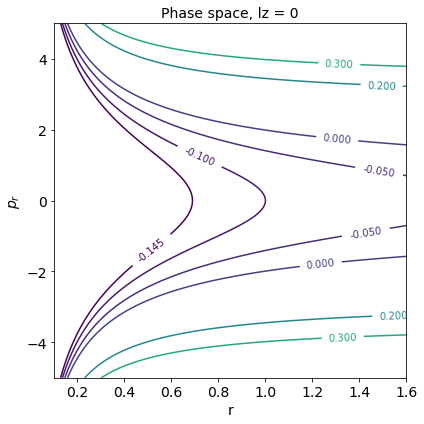

In [21]:
from matplotlib import cm
%matplotlib inline
m1 = 2000
m2 = 20
m = m1*m2/(m1+m2)
#m = 20
lz = 0
k = 0.1
pi = np.pi                      # definitions

# create a figure and axes

fig, ax1 = plt.subplots(nrows=1, ncols=1,figsize=(6,6))

ax1.set_xlabel('r', fontsize = 14)
ax1.set_ylabel(r'$p_r$', fontsize = 14)
ax1.set_title('Phase space, lz = 0', fontsize = 14)
plt.yticks(fontsize = 14)
plt.xticks(fontsize = 14)
rcont = np.linspace(0.1,1.6,400)
pcont = np.linspace(-5,5,400)
rcont, pcont = np.meshgrid(rcont, pcont)
ham = (pcont**2/(2*m) + lz**2/(2*m*rcont**2) - k/rcont)

cs = ax1.contour(rcont,pcont,ham, levels = [-0.145,-0.1,-0.05,0,0.2, 0.3,0.6])
ax1.clabel(cs, cs.levels, inline=True, fontsize=10)
ax1.text(1,-3, r'$\frac{m_2}{m_1} = 100$', color='white', fontsize=18)

plt.tight_layout()

In [22]:
fig.savefig('lz_equal_zero_contours.pdf')